In [1]:
import pandas as pd

In [2]:
from maskrcnn.postprocess.resample import Resampler
from maskrcnn.postprocess.polygonize import load_anns

In [3]:
# AOI index data w/ georeferencing info
AOI_IN_DIR = 'data/Experiment4/aoi.csv'
# download log data
LOG_IN_DIR = 'data/Experiment4/aoi_download_log.csv'

In [4]:
# satellite derived data
SAT_IN_ANN_DIR = 'data/Siaya/Pred/infer/'
SAT_IN_IMG_DIR = 'data/Siaya/Image/'

In [5]:
# read image index data frame
df = pd.merge(pd.read_csv(AOI_IN_DIR),
              pd.read_csv(LOG_IN_DIR).loc[:, 'index'],
              how='right', on='index')

In [6]:
# link all inference data
r = Resampler.from_bounds(
    img_dir=SAT_IN_IMG_DIR,
    ann_dir=SAT_IN_ANN_DIR,
    indices=df['index'].values.tolist(),
    bounds=df[['lon_min', 'lat_min', 'lon_max', 'lat_max']].values.tolist())

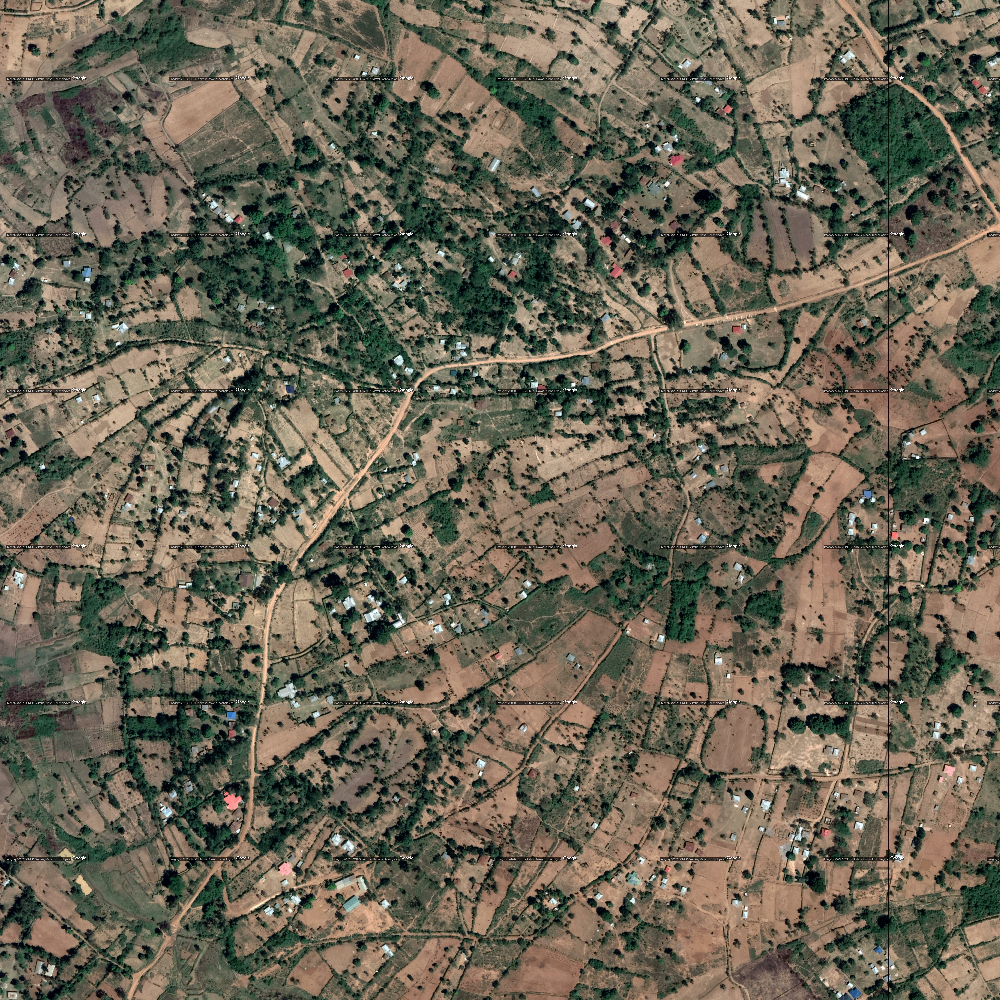

In [7]:
bounds = (34.291580, 0.125352, 34.302074, 0.136352)
r.plot(bounds=bounds, width=5000, height=5000, mode='img')
r.output